In [1]:
!pip install torch
!pip install torchvision

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 114.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 80.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 54.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 8.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 7.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 29.1 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvjitli

In [2]:
import numpy as np
import os
import matplotlib.pyplot as plt

import torch
import torchvision
from torchvision import models, transforms, datasets

import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

In [6]:
from torch.utils.data import Dataset

# Loading data

In [3]:
!tar -xvf /content/maps.tar.gz -C /content/

maps/
maps/train/
maps/train/1.jpg
maps/train/10.jpg
maps/train/100.jpg
maps/train/1000.jpg
maps/train/1001.jpg
maps/train/1002.jpg
maps/train/1003.jpg
maps/train/1004.jpg
maps/train/1005.jpg
maps/train/1006.jpg
maps/train/1007.jpg
maps/train/1008.jpg
maps/train/1009.jpg
maps/train/101.jpg
maps/train/1010.jpg
maps/train/1011.jpg
maps/train/1012.jpg
maps/train/1013.jpg
maps/train/1014.jpg
maps/train/1015.jpg
maps/train/530.jpg
maps/train/531.jpg
maps/train/532.jpg
maps/train/533.jpg
maps/train/534.jpg
maps/train/535.jpg
maps/train/536.jpg
maps/train/537.jpg
maps/train/538.jpg
maps/train/539.jpg
maps/train/54.jpg
maps/train/540.jpg
maps/train/541.jpg
maps/train/542.jpg
maps/train/543.jpg
maps/train/544.jpg
maps/train/545.jpg
maps/train/546.jpg
maps/train/547.jpg
maps/train/548.jpg
maps/train/549.jpg
maps/train/55.jpg
maps/train/550.jpg
maps/train/551.jpg
maps/train/552.jpg
maps/train/553.jpg
maps/train/554.jpg
maps/train/555.jpg
maps/train/556.jpg
maps/train/557.jpg
maps/train/558.jpg
ma

In [4]:
data_dir = "/content/maps"

data_transform = transforms.Compose([
    transforms.Resize((256, 512)),
    transforms.CenterCrop((256, 512)),
    transforms.RandomVerticalFlip(p=0.5),
    transforms.ToTensor(),
    transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])
])

In [8]:
# Creating a custom class for loading the train and val data
class Pix2PixDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.image_files = [f for f in os.listdir(root_dir) if os.path.isfile(os.path.join(root_dir, f))]

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        image_path = os.path.join(self.root_dir, self.image_files[idx])
        image = Image.open(image_path).convert('RGB')

        if self.transform:
            image = self.transform(image)

        return image

dataset_train = Pix2PixDataset(root_dir=os.path.join(data_dir, "train"), transform=data_transform)
dataset_val = Pix2PixDataset(root_dir=os.path.join(data_dir, "val"), transform=data_transform)

dataloader_train = torch.utils.data.DataLoader(dataset_train, batch_size=1, shuffle=True, num_workers=0)
dataloader_val = torch.utils.data.DataLoader(dataset_val, batch_size=24, shuffle=True, num_workers=0)

In [9]:
print(len(dataset_train))
print(len(dataset_val))

1096
1098


### **Show Image Function**

In [14]:
def show_image(img, title="No title", figsize=(5,5)):
    img = img.numpy().transpose(1,2,0)
    mean = np.array([0.5, 0.5, 0.5])
    std = np.array([0.5, 0.5, 0.5])

    img = img * std + mean
    np.clip(img, 0, 1)

    plt.figure(figsize=figsize)
    plt.imshow(img)
    plt.title(title)

torch.Size([3, 256, 256])


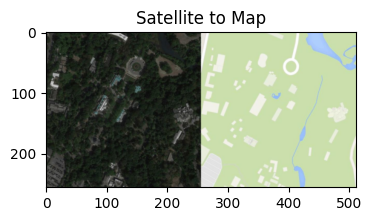

In [19]:
from PIL import Image

images = next(iter(dataloader_train))

sample_sat = images[0][:,:,:256]
sample_map = images[0][:,:,256:]
print(sample_sat.shape)  # Check shape before visualizing

show_image(images[0], title="Satellite to Map", figsize=(4,4))

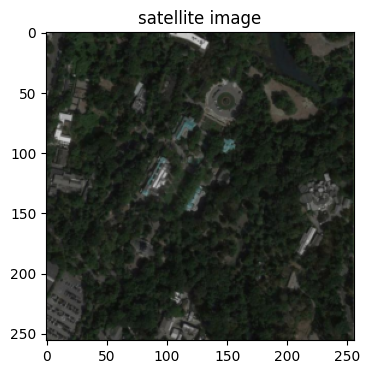

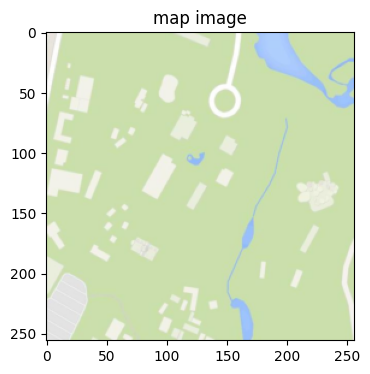

In [20]:
show_image(img = sample_sat, title = "satellite image", figsize=(4,4))
show_image(img = sample_map, title = "map image", figsize=(4, 4))

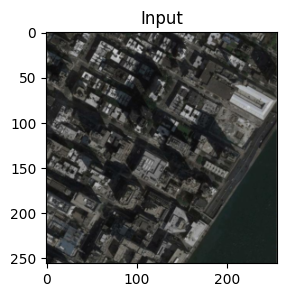

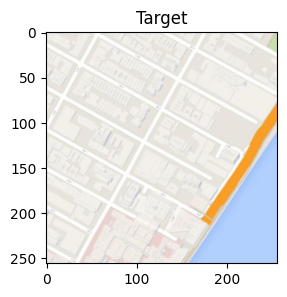

In [21]:
images = next(iter(dataloader_train))

x = torchvision.utils.make_grid(images[:,:,:,:256], padding=10)
y = torchvision.utils.make_grid(images[:,:,:,256:], padding=10)

show_image(x, title="Input", figsize=(3,3))
show_image(y, title="Target", figsize=(3,3))

### **Intializing Model weights**

In [22]:
def weights_init(m):
    name = m.__class__.__name__

    if(name.find("Conv") > -1):
        nn.init.normal_(m.weight.data, 0.0, 0.02) # ~N(mean=0.0, std=0.02)
    elif(name.find("BatchNorm") > -1):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0.0)

# Generator - Architecture
* The architecture is U-Net 256

* In 3 x 256 x 256 - Encoder C64 - C128 - C256 - C512 - C512 - C512
- C512 (Latent space)
* Decoder DC1024 - DC1024 - DC1024 - DC512 - DC256 - DC128 - Out 3 x 256 x 256
* Reference: https://arxiv.org/pdf/1505.04597.pdf

In [23]:
"""
    The Generator is a U-Net 256 with skip connections between Encoder and Decoder
"""

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu

        """
        ===== Encoder ======

        * Encoder has the following architecture:
        0) Inp3
        1) C64
        2) Leaky, C128, Norm
        3) Leaky, C256, Norm
        4) Leaky, C512, Norm
        5) Leaky, C512, Norm
        6) Leaky, C512, Norm
        7) Leaky, C512

        * The structure of 1 encoder block is:
        1) LeakyReLU(prev layer)
        2) Conv2D
        3) BatchNorm

        Where Conv2D has kernel_size-4, stride=2, padding=1 for all layers
        """
        self.encoder1 = nn.Conv2d(in_channels=3, out_channels=64, kernel_size=4, stride=2, padding=1, bias=False)

        self.encoder2 = nn.Sequential(
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128)
        )

        self.encoder3 = nn.Sequential(
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
        )

        self.encoder4 = nn.Sequential(
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512)
        )

        self.encoder5 = nn.Sequential(
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512)
        )

        self.encoder6 = nn.Sequential(
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512)
        )

        self.encoder7 = nn.Sequential(
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=4, stride=2, padding=1, bias=False)
        )

        """
        ===== Decoder =====
        * Decoder has the following architecture:
        1) ReLU(from latent space), DC512, Norm, Drop 0.5 - Residual
        2) ReLU, DC512, Norm, Drop 0.5, Residual
        3) ReLU, DC512, Norm, Drop 0.5, Residual
        4) ReLU, DC256, Norm, Residual
        5) ReLU, DC128, Norm, Residual
        6) ReLU, DC64, Norm, Residual
        7) ReLU, DC3, Tanh()

        * Note: only apply Dropout in the first 3 Decoder layers

        * The structure of each Decoder block is:
        1) ReLU(from prev layer)
        2) ConvTranspose2D
        3) BatchNorm
        4) Dropout
        5) Skip connection

        Where ConvTranpose2D has kernel_size=4, stride=2, padding=1
        """
        self.decoder1 = nn.Sequential(
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(in_channels=512, out_channels=512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.Dropout(0.5)
        )
        # skip connection in forward()

        self.decoder2 = nn.Sequential(
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(in_channels=512*2, out_channels=512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.Dropout(0.5)
        )
        # skip connection in forward()

        self.decoder3 = nn.Sequential(
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(in_channels=512*2, out_channels=512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.Dropout(0.5)
        )
        # skip connection in forward()

        self.decoder4 = nn.Sequential(
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(in_channels=512*2, out_channels=256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            #nn.Dropout(0.5)
        )

        self.decoder5 = nn.Sequential(
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(in_channels=256*2, out_channels=128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            #nn.Dropout(0.5)
        )

        self.decoder6 = nn.Sequential(
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(in_channels=128*2, out_channels=64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            #nn.Dropout(0.5)
        )

        self.decoder7 = nn.Sequential(
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(in_channels=64*2, out_channels=3, kernel_size=4, stride=2, padding=1, bias=False),
            nn.Tanh()
        )

    def forward(self, x):
        e1 = self.encoder1(x)
        e2 = self.encoder2(e1)
        e3 = self.encoder3(e2)
        e4 = self.encoder4(e3)
        e5 = self.encoder5(e4)
        e6 = self.encoder6(e5)

        latent_space = self.encoder7(e6)

        d1 = torch.cat([self.decoder1(latent_space), e6], dim=1)
        d2 = torch.cat([self.decoder2(d1), e5], dim=1)
        d3 = torch.cat([self.decoder3(d2), e4], dim=1)
        d4 = torch.cat([self.decoder4(d3), e3], dim=1)
        d5 = torch.cat([self.decoder5(d4), e2], dim=1)
        d6 = torch.cat([self.decoder6(d5), e1], dim=1)

        out = self.decoder7(d6)

        return out

# Generator - Initialization

In [26]:
# Hyperparameters as suggested by the original paper
bs=1
lr=0.0002
beta1=0.5
beta2=0.999
NUM_EPOCHS = 200
ngpu = 1
L1_lambda = 100

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [27]:
model_G = Generator(ngpu=1)

if(device == "cuda" and ngpu > 1):
    model_G = nn.DataParallel(model_G, list(range(ngpu)))

model_G.apply(weights_init)
model_G.to(device)

Generator(
  (encoder1): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (encoder2): Sequential(
    (0): LeakyReLU(negative_slope=0.2, inplace=True)
    (1): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (encoder3): Sequential(
    (0): LeakyReLU(negative_slope=0.2, inplace=True)
    (1): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (encoder4): Sequential(
    (0): LeakyReLU(negative_slope=0.2, inplace=True)
    (1): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (2): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (encoder5): Sequential(
    (0): LeakyReLU(negative_slope=0.2, inplace=True)
    (1): Conv2d(512, 512, kernel_s

# Discriminator - Architecture
* PatchGan Discriminator with receptive field of each patch is **rf = 70x70**
* Structure is **C64 (no norm, 4,2,1)-C128 (4,2,1)-C256 (4,2,1)-C512 (4,1,1) - Channel 1 (4,1,1)**, where C is Convolution - BatchNorm - LeakyReLU
* Activations are **LeakyReLU(0.2)**
* BatchNorm is applied to all layers but C64
* Last 2 layers has **kernel_size=4, stride=1, padding=1**

In [28]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu

        self.structure = nn.Sequential(
            nn.Conv2d(in_channels=3*2, out_channels=64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(in_channels=64, out_channels= 128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=4, stride=1, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(in_channels=512, out_channels=1, kernel_size=4, stride=1, padding=1, bias=False),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.structure(x)

# Discriminator Initialization

In [29]:
model_D = Discriminator(ngpu=1)

if(device == "cuda" and ngpu>1):
    model_D = torch.DataParallel(model_D, list(rang(ngpu)))

model_D.apply(weights_init)
model_D.to(device)

Discriminator(
  (structure): Sequential(
    (0): Conv2d(6, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1), bias=False)
    (12): Sigmoid()
  )
)

# Training process
* We train Generator 2 times for each time we train Discriminator

* Let $x$ be the input satellite image and $y$ be the ground-truth map image. The objective is to train the U-Net Generator $G$ so that it can translate satellite image to a map image as realistic as possible.

In [31]:
criterion = nn.BCELoss()

optimizerD = optim.Adam(model_D.parameters(), lr=lr, betas=(beta1, beta2))
optimizerG = optim.Adam(model_G.parameters(), lr=lr, betas=(beta1, beta2))


model_D.to(device)
model_G.to(device)
print()

In [32]:
out1 = model_D(torch.cat([images[:,:,:,:256].to(device), images[:,:,:,256:].to(device)], dim=1)).to(device)
out2 = torch.ones(size=out1.shape, dtype=torch.float, device=device)

print(out1.shape)
print(criterion(out1, out2))

torch.Size([1, 1, 30, 30])
tensor(0.7577, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)


In [37]:
L1_lambda = 100
NUM_EPOCHS= 100

In [38]:
from tqdm import tqdm
import time
import torch
import os

CHECKPOINT_PATH = "./checkpoint.pth"
START_EPOCH = 0
best_lossG = float("inf")

# === Load from checkpoint if it exists
if os.path.exists(CHECKPOINT_PATH):
    print("Loading checkpoint...")
    checkpoint = torch.load(CHECKPOINT_PATH)
    model_G.load_state_dict(checkpoint["model_G"])
    model_D.load_state_dict(checkpoint["model_D"])
    optimizerG.load_state_dict(checkpoint["optimizerG"])
    optimizerD.load_state_dict(checkpoint["optimizerD"])
    START_EPOCH = checkpoint["epoch"] + 1
    best_lossG = checkpoint.get("best_lossG", float("inf"))
    print(f"Resuming from epoch {START_EPOCH}...")

for epoch in range(START_EPOCH, NUM_EPOCHS + 1):
    print(f"\nStarting Epoch {epoch + 1}/{NUM_EPOCHS}")
    start_time = time.time()

    epoch_lossD_real = 0.0
    epoch_lossD_fake = 0.0
    epoch_lossG = 0.0

    num_batches = len(dataloader_train)
    batch_bar = tqdm(enumerate(dataloader_train), total=num_batches, desc=f"Epoch {epoch + 1}")

    for batch_idx, images in batch_bar:
        model_D.zero_grad()

        inputs = images[:, :, :, :256].to(device)
        targets = images[:, :, :, 256:].to(device)

        # === Discriminator real
        real_data = torch.cat([inputs, targets], dim=1)
        outputs = model_D(real_data)
        labels = torch.ones_like(outputs, dtype=torch.float, device=device)

        lossD_real = 0.5 * criterion(outputs, labels)
        lossD_real.backward()
        epoch_lossD_real += lossD_real.item()

        # === Discriminator fake
        gens = model_G(inputs).detach()
        fake_data = torch.cat([inputs, gens], dim=1)
        outputs = model_D(fake_data)
        labels = torch.zeros_like(outputs, dtype=torch.float, device=device)

        lossD_fake = 0.5 * criterion(outputs, labels)
        lossD_fake.backward()
        epoch_lossD_fake += lossD_fake.item()

        optimizerD.step()

        # === Generator (x2)
        for i in range(2):
            model_G.zero_grad()

            gens = model_G(inputs)
            gen_data = torch.cat([inputs, gens], dim=1)
            outputs = model_D(gen_data)
            labels = torch.ones_like(outputs, dtype=torch.float, device=device)

            lossG = criterion(outputs, labels) + L1_lambda * torch.abs(gens - targets).sum()
            lossG.backward()
            optimizerG.step()

            epoch_lossG += lossG.item()

        batch_bar.set_postfix({
            "lossD_real": f"{lossD_real.item():.4f}",
            "lossD_fake": f"{lossD_fake.item():.4f}",
            "lossG": f"{lossG.item():.4f}",
        })

    elapsed = time.time() - start_time
    print(f"Epoch {epoch + 1} completed in {elapsed:.2f}s")
    print(f"Avg Losses: D_real: {epoch_lossD_real / num_batches:.4f}, D_fake: {epoch_lossD_fake / num_batches:.4f}, G: {epoch_lossG / (2 * num_batches):.4f}")

    # === Save checkpoint every epoch
    checkpoint = {
        "epoch": epoch,
        "model_G": model_G.state_dict(),
        "model_D": model_D.state_dict(),
        "optimizerG": optimizerG.state_dict(),
        "optimizerD": optimizerD.state_dict(),
        "best_lossG": min(best_lossG, epoch_lossG / (2 * num_batches))
    }
    torch.save(checkpoint, CHECKPOINT_PATH)

    # === Save models separately every 5 epochs
    if epoch % 5 == 0:
        torch.save(model_G, f"./sat2mapGen_epoch{epoch}.pth")
        torch.save(model_D, f"./sat2mapDisc_epoch{epoch}.pth")

print("Training Complete!")


Starting Epoch 1/100


Epoch 1: 100%|██████████| 1096/1096 [02:22<00:00,  7.68it/s, lossD_real=0.0005, lossD_fake=0.0010, lossG=1866536.6250]


Epoch 1 completed in 142.71s
Avg Losses: D_real: 0.0372, D_fake: 0.0287, G: 1583134.2235

Starting Epoch 2/100


Epoch 2: 100%|██████████| 1096/1096 [02:22<00:00,  7.69it/s, lossD_real=0.1708, lossD_fake=0.1499, lossG=1360320.0000]


Epoch 2 completed in 142.54s
Avg Losses: D_real: 0.0320, D_fake: 0.0282, G: 1481598.7731

Starting Epoch 3/100


Epoch 3: 100%|██████████| 1096/1096 [02:22<00:00,  7.69it/s, lossD_real=0.0002, lossD_fake=0.0017, lossG=1517339.3750]


Epoch 3 completed in 142.55s
Avg Losses: D_real: 0.0206, D_fake: 0.0171, G: 1408760.2806

Starting Epoch 4/100


Epoch 4: 100%|██████████| 1096/1096 [02:22<00:00,  7.70it/s, lossD_real=0.0000, lossD_fake=0.0015, lossG=1559773.1250]


Epoch 4 completed in 142.39s
Avg Losses: D_real: 0.0138, D_fake: 0.0100, G: 1358773.0931

Starting Epoch 5/100


Epoch 5: 100%|██████████| 1096/1096 [02:22<00:00,  7.70it/s, lossD_real=0.0152, lossD_fake=0.0157, lossG=815606.4375]


Epoch 5 completed in 142.40s
Avg Losses: D_real: 0.0219, D_fake: 0.0325, G: 1313194.4049

Starting Epoch 6/100


Epoch 6: 100%|██████████| 1096/1096 [02:22<00:00,  7.68it/s, lossD_real=0.0001, lossD_fake=0.0004, lossG=1629026.8750]


Epoch 6 completed in 142.68s
Avg Losses: D_real: 0.0115, D_fake: 0.0095, G: 1274735.8251

Starting Epoch 7/100


Epoch 7: 100%|██████████| 1096/1096 [02:22<00:00,  7.69it/s, lossD_real=0.0001, lossD_fake=0.0008, lossG=1156620.6250]


Epoch 7 completed in 142.48s
Avg Losses: D_real: 0.0141, D_fake: 0.0149, G: 1233852.2120

Starting Epoch 8/100


Epoch 8: 100%|██████████| 1096/1096 [02:22<00:00,  7.70it/s, lossD_real=0.0000, lossD_fake=0.0001, lossG=1855995.8750]


Epoch 8 completed in 142.35s
Avg Losses: D_real: 0.0104, D_fake: 0.0078, G: 1197957.5561

Starting Epoch 9/100


Epoch 9: 100%|██████████| 1096/1096 [02:22<00:00,  7.69it/s, lossD_real=0.0072, lossD_fake=0.0003, lossG=888063.8750]


Epoch 9 completed in 142.44s
Avg Losses: D_real: 0.0086, D_fake: 0.0066, G: 1178415.9099

Starting Epoch 10/100


Epoch 10: 100%|██████████| 1096/1096 [02:22<00:00,  7.69it/s, lossD_real=0.0000, lossD_fake=0.0004, lossG=2163088.7500]


Epoch 10 completed in 142.46s
Avg Losses: D_real: 0.0166, D_fake: 0.0164, G: 1138725.8949

Starting Epoch 11/100


Epoch 11: 100%|██████████| 1096/1096 [02:22<00:00,  7.69it/s, lossD_real=0.0001, lossD_fake=0.0001, lossG=907279.4375]


Epoch 11 completed in 142.45s
Avg Losses: D_real: 0.0054, D_fake: 0.0049, G: 1109064.9848

Starting Epoch 12/100


Epoch 12: 100%|██████████| 1096/1096 [02:22<00:00,  7.70it/s, lossD_real=0.0001, lossD_fake=0.0004, lossG=1165166.8750]


Epoch 12 completed in 142.38s
Avg Losses: D_real: 0.0110, D_fake: 0.0110, G: 1081028.8886

Starting Epoch 13/100


Epoch 13: 100%|██████████| 1096/1096 [02:22<00:00,  7.71it/s, lossD_real=0.0000, lossD_fake=0.0002, lossG=957229.6875]


Epoch 13 completed in 142.17s
Avg Losses: D_real: 0.0050, D_fake: 0.0032, G: 1054104.3021

Starting Epoch 14/100


Epoch 14: 100%|██████████| 1096/1096 [02:22<00:00,  7.70it/s, lossD_real=0.0002, lossD_fake=0.0001, lossG=850578.3750]


Epoch 14 completed in 142.37s
Avg Losses: D_real: 0.0129, D_fake: 0.0105, G: 1031372.2678

Starting Epoch 15/100


Epoch 15: 100%|██████████| 1096/1096 [02:22<00:00,  7.70it/s, lossD_real=0.0000, lossD_fake=0.0018, lossG=1594349.6250]


Epoch 15 completed in 142.25s
Avg Losses: D_real: 0.0074, D_fake: 0.0067, G: 1000853.0265

Starting Epoch 16/100


Epoch 16: 100%|██████████| 1096/1096 [02:22<00:00,  7.69it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=1001736.1250]


Epoch 16 completed in 142.61s
Avg Losses: D_real: 0.0037, D_fake: 0.0033, G: 976103.1553

Starting Epoch 17/100


Epoch 17: 100%|██████████| 1096/1096 [02:22<00:00,  7.68it/s, lossD_real=0.0010, lossD_fake=0.0001, lossG=724547.0625]


Epoch 17 completed in 142.64s
Avg Losses: D_real: 0.0079, D_fake: 0.0088, G: 958039.1119

Starting Epoch 18/100


Epoch 18: 100%|██████████| 1096/1096 [02:22<00:00,  7.68it/s, lossD_real=0.0000, lossD_fake=0.0004, lossG=920400.5000]


Epoch 18 completed in 142.68s
Avg Losses: D_real: 0.0073, D_fake: 0.0053, G: 928308.1100

Starting Epoch 19/100


Epoch 19: 100%|██████████| 1096/1096 [02:22<00:00,  7.68it/s, lossD_real=0.0000, lossD_fake=0.0001, lossG=366013.6562]


Epoch 19 completed in 142.69s
Avg Losses: D_real: 0.0014, D_fake: 0.0013, G: 909299.4635

Starting Epoch 20/100


Epoch 20: 100%|██████████| 1096/1096 [02:22<00:00,  7.68it/s, lossD_real=0.0000, lossD_fake=0.0001, lossG=619443.8125]


Epoch 20 completed in 142.67s
Avg Losses: D_real: 0.0109, D_fake: 0.0084, G: 884756.6163

Starting Epoch 21/100


Epoch 21: 100%|██████████| 1096/1096 [02:22<00:00,  7.67it/s, lossD_real=0.1002, lossD_fake=0.0001, lossG=148530.7656]


Epoch 21 completed in 142.91s
Avg Losses: D_real: 0.0076, D_fake: 0.0069, G: 864958.4852

Starting Epoch 22/100


Epoch 22: 100%|██████████| 1096/1096 [02:22<00:00,  7.68it/s, lossD_real=0.0000, lossD_fake=0.0001, lossG=1185726.3750]


Epoch 22 completed in 142.78s
Avg Losses: D_real: 0.0036, D_fake: 0.0035, G: 844152.2562

Starting Epoch 23/100


Epoch 23: 100%|██████████| 1096/1096 [02:23<00:00,  7.65it/s, lossD_real=0.0001, lossD_fake=0.0004, lossG=1037349.3750]


Epoch 23 completed in 143.22s
Avg Losses: D_real: 0.0087, D_fake: 0.0306, G: 826792.2855

Starting Epoch 24/100


Epoch 24: 100%|██████████| 1096/1096 [02:22<00:00,  7.67it/s, lossD_real=0.0000, lossD_fake=0.0001, lossG=1951631.5000]


Epoch 24 completed in 142.92s
Avg Losses: D_real: 0.0031, D_fake: 0.0031, G: 809197.7590

Starting Epoch 25/100


Epoch 25: 100%|██████████| 1096/1096 [02:22<00:00,  7.67it/s, lossD_real=0.0000, lossD_fake=0.0001, lossG=644941.6875]


Epoch 25 completed in 142.93s
Avg Losses: D_real: 0.0086, D_fake: 0.0066, G: 793547.2423

Starting Epoch 26/100


Epoch 26: 100%|██████████| 1096/1096 [02:22<00:00,  7.67it/s, lossD_real=0.0000, lossD_fake=0.0001, lossG=1055956.5000]


Epoch 26 completed in 142.94s
Avg Losses: D_real: 0.0021, D_fake: 0.0020, G: 777840.7797

Starting Epoch 27/100


Epoch 27: 100%|██████████| 1096/1096 [02:22<00:00,  7.68it/s, lossD_real=0.0000, lossD_fake=0.0083, lossG=790514.3125]


Epoch 27 completed in 142.80s
Avg Losses: D_real: 0.0017, D_fake: 0.0020, G: 766183.0681

Starting Epoch 28/100


Epoch 28: 100%|██████████| 1096/1096 [02:22<00:00,  7.68it/s, lossD_real=0.0000, lossD_fake=0.0003, lossG=328014.5312]


Epoch 28 completed in 142.62s
Avg Losses: D_real: 0.0084, D_fake: 0.0070, G: 747789.5425

Starting Epoch 29/100


Epoch 29: 100%|██████████| 1096/1096 [02:22<00:00,  7.67it/s, lossD_real=0.0000, lossD_fake=0.0002, lossG=822574.8750]


Epoch 29 completed in 142.87s
Avg Losses: D_real: 0.0010, D_fake: 0.0010, G: 739950.6078

Starting Epoch 30/100


Epoch 30: 100%|██████████| 1096/1096 [02:22<00:00,  7.68it/s, lossD_real=0.0000, lossD_fake=0.0001, lossG=971729.1875]


Epoch 30 completed in 142.73s
Avg Losses: D_real: 0.0074, D_fake: 0.0072, G: 726857.5191

Starting Epoch 31/100


Epoch 31: 100%|██████████| 1096/1096 [02:22<00:00,  7.68it/s, lossD_real=0.0000, lossD_fake=0.0001, lossG=648562.0000]


Epoch 31 completed in 142.62s
Avg Losses: D_real: 0.0020, D_fake: 0.0018, G: 715464.0512

Starting Epoch 32/100


Epoch 32: 100%|██████████| 1096/1096 [02:22<00:00,  7.67it/s, lossD_real=0.0000, lossD_fake=0.0003, lossG=1014080.6875]


Epoch 32 completed in 142.89s
Avg Losses: D_real: 0.0005, D_fake: 0.0005, G: 703675.6808

Starting Epoch 33/100


Epoch 33: 100%|██████████| 1096/1096 [02:22<00:00,  7.68it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=760274.0625]


Epoch 33 completed in 142.66s
Avg Losses: D_real: 0.0048, D_fake: 0.0048, G: 695968.9249

Starting Epoch 34/100


Epoch 34: 100%|██████████| 1096/1096 [02:22<00:00,  7.67it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=672521.6250]


Epoch 34 completed in 142.83s
Avg Losses: D_real: 0.0115, D_fake: 0.0073, G: 682511.4502

Starting Epoch 35/100


Epoch 35: 100%|██████████| 1096/1096 [02:22<00:00,  7.68it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=799274.8125]


Epoch 35 completed in 142.65s
Avg Losses: D_real: 0.0005, D_fake: 0.0005, G: 675475.2165

Starting Epoch 36/100


Epoch 36: 100%|██████████| 1096/1096 [02:22<00:00,  7.69it/s, lossD_real=0.0000, lossD_fake=0.0010, lossG=557061.7500]


Epoch 36 completed in 142.60s
Avg Losses: D_real: 0.0058, D_fake: 0.0042, G: 665537.7919

Starting Epoch 37/100


Epoch 37: 100%|██████████| 1096/1096 [02:22<00:00,  7.67it/s, lossD_real=0.0000, lossD_fake=0.0005, lossG=554615.4375]


Epoch 37 completed in 142.83s
Avg Losses: D_real: 0.0017, D_fake: 0.0014, G: 654203.2064

Starting Epoch 38/100


Epoch 38: 100%|██████████| 1096/1096 [02:22<00:00,  7.67it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=700837.1875]


Epoch 38 completed in 142.86s
Avg Losses: D_real: 0.0112, D_fake: 0.0110, G: 648006.0514

Starting Epoch 39/100


Epoch 39: 100%|██████████| 1096/1096 [02:22<00:00,  7.68it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=722455.8125]


Epoch 39 completed in 142.74s
Avg Losses: D_real: 0.0040, D_fake: 0.0053, G: 638883.5521

Starting Epoch 40/100


Epoch 40: 100%|██████████| 1096/1096 [02:22<00:00,  7.67it/s, lossD_real=0.0000, lossD_fake=0.0001, lossG=609038.5000]


Epoch 40 completed in 142.90s
Avg Losses: D_real: 0.0007, D_fake: 0.0007, G: 628873.3261

Starting Epoch 41/100


Epoch 41: 100%|██████████| 1096/1096 [02:22<00:00,  7.67it/s, lossD_real=0.0000, lossD_fake=0.0001, lossG=792315.7500]


Epoch 41 completed in 142.96s
Avg Losses: D_real: 0.0051, D_fake: 0.0038, G: 620789.5175

Starting Epoch 42/100


Epoch 42: 100%|██████████| 1096/1096 [02:22<00:00,  7.67it/s, lossD_real=0.0000, lossD_fake=0.0022, lossG=696944.5000]


Epoch 42 completed in 142.90s
Avg Losses: D_real: 0.0044, D_fake: 0.0047, G: 609967.7961

Starting Epoch 43/100


Epoch 43: 100%|██████████| 1096/1096 [02:22<00:00,  7.67it/s, lossD_real=0.0000, lossD_fake=0.0001, lossG=521456.3125]


Epoch 43 completed in 142.92s
Avg Losses: D_real: 0.0084, D_fake: 0.0076, G: 602598.0259

Starting Epoch 44/100


Epoch 44: 100%|██████████| 1096/1096 [02:22<00:00,  7.67it/s, lossD_real=0.0059, lossD_fake=0.0001, lossG=350007.6875]


Epoch 44 completed in 142.82s
Avg Losses: D_real: 0.0058, D_fake: 0.0045, G: 595085.5973

Starting Epoch 45/100


Epoch 45: 100%|██████████| 1096/1096 [02:22<00:00,  7.67it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=486572.2188]


Epoch 45 completed in 142.85s
Avg Losses: D_real: 0.0057, D_fake: 0.0043, G: 584091.9342

Starting Epoch 46/100


Epoch 46: 100%|██████████| 1096/1096 [02:22<00:00,  7.67it/s, lossD_real=0.2479, lossD_fake=0.0000, lossG=373295.3750]


Epoch 46 completed in 142.98s
Avg Losses: D_real: 0.0072, D_fake: 0.0083, G: 577200.1580

Starting Epoch 47/100


Epoch 47: 100%|██████████| 1096/1096 [02:22<00:00,  7.68it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=685996.5000]


Epoch 47 completed in 142.69s
Avg Losses: D_real: 0.0067, D_fake: 0.0141, G: 570863.5551

Starting Epoch 48/100


Epoch 48: 100%|██████████| 1096/1096 [02:22<00:00,  7.67it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=874722.9375]


Epoch 48 completed in 142.83s
Avg Losses: D_real: 0.0059, D_fake: 0.0051, G: 565213.3645

Starting Epoch 49/100


Epoch 49: 100%|██████████| 1096/1096 [02:22<00:00,  7.69it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=759847.1875]


Epoch 49 completed in 142.59s
Avg Losses: D_real: 0.0041, D_fake: 0.0035, G: 560096.6155

Starting Epoch 50/100


Epoch 50: 100%|██████████| 1096/1096 [02:22<00:00,  7.67it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=748303.1250]


Epoch 50 completed in 142.88s
Avg Losses: D_real: 0.0121, D_fake: 0.0133, G: 553998.8178

Starting Epoch 51/100


Epoch 51: 100%|██████████| 1096/1096 [02:22<00:00,  7.67it/s, lossD_real=0.0001, lossD_fake=0.0001, lossG=373670.0312]


Epoch 51 completed in 142.84s
Avg Losses: D_real: 0.0030, D_fake: 0.0038, G: 546024.7627

Starting Epoch 52/100


Epoch 52: 100%|██████████| 1096/1096 [02:23<00:00,  7.66it/s, lossD_real=0.0000, lossD_fake=0.0001, lossG=561415.8750]


Epoch 52 completed in 143.08s
Avg Losses: D_real: 0.0038, D_fake: 0.0041, G: 540234.8137

Starting Epoch 53/100


Epoch 53: 100%|██████████| 1096/1096 [02:22<00:00,  7.68it/s, lossD_real=0.0000, lossD_fake=0.0001, lossG=449812.4688]


Epoch 53 completed in 142.73s
Avg Losses: D_real: 0.0047, D_fake: 0.0040, G: 536282.2714

Starting Epoch 54/100


Epoch 54: 100%|██████████| 1096/1096 [02:22<00:00,  7.68it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=121829.0469]


Epoch 54 completed in 142.78s
Avg Losses: D_real: 0.0049, D_fake: 0.0050, G: 529057.2995

Starting Epoch 55/100


Epoch 55: 100%|██████████| 1096/1096 [02:22<00:00,  7.67it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=574545.0625]


Epoch 55 completed in 142.96s
Avg Losses: D_real: 0.0057, D_fake: 0.0057, G: 525045.5506

Starting Epoch 56/100


Epoch 56: 100%|██████████| 1096/1096 [02:22<00:00,  7.68it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=243140.5469]


Epoch 56 completed in 142.66s
Avg Losses: D_real: 0.0063, D_fake: 0.0048, G: 521531.0708

Starting Epoch 57/100


Epoch 57: 100%|██████████| 1096/1096 [02:22<00:00,  7.67it/s, lossD_real=0.0006, lossD_fake=0.0291, lossG=248997.8594]


Epoch 57 completed in 142.81s
Avg Losses: D_real: 0.0064, D_fake: 0.0079, G: 514693.3143

Starting Epoch 58/100


Epoch 58: 100%|██████████| 1096/1096 [02:22<00:00,  7.69it/s, lossD_real=0.0000, lossD_fake=0.0009, lossG=372881.0625]


Epoch 58 completed in 142.52s
Avg Losses: D_real: 0.0017, D_fake: 0.0018, G: 510565.8439

Starting Epoch 59/100


Epoch 59: 100%|██████████| 1096/1096 [02:22<00:00,  7.68it/s, lossD_real=0.0000, lossD_fake=0.0001, lossG=430937.7500]


Epoch 59 completed in 142.72s
Avg Losses: D_real: 0.0012, D_fake: 0.0012, G: 507420.1732

Starting Epoch 60/100


Epoch 60: 100%|██████████| 1096/1096 [02:22<00:00,  7.67it/s, lossD_real=0.0000, lossD_fake=0.0013, lossG=703413.5000]


Epoch 60 completed in 142.83s
Avg Losses: D_real: 0.0096, D_fake: 0.0098, G: 504298.7850

Starting Epoch 61/100


Epoch 61: 100%|██████████| 1096/1096 [02:22<00:00,  7.68it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=809117.2500]


Epoch 61 completed in 142.79s
Avg Losses: D_real: 0.0075, D_fake: 0.0071, G: 499125.7835

Starting Epoch 62/100


Epoch 62: 100%|██████████| 1096/1096 [02:23<00:00,  7.66it/s, lossD_real=0.0001, lossD_fake=0.0002, lossG=568418.0000]


Epoch 62 completed in 143.07s
Avg Losses: D_real: 0.0048, D_fake: 0.0040, G: 494629.6602

Starting Epoch 63/100


Epoch 63: 100%|██████████| 1096/1096 [02:22<00:00,  7.68it/s, lossD_real=0.0000, lossD_fake=0.0049, lossG=192245.2656]


Epoch 63 completed in 142.76s
Avg Losses: D_real: 0.0007, D_fake: 0.0006, G: 491347.8217

Starting Epoch 64/100


Epoch 64: 100%|██████████| 1096/1096 [02:22<00:00,  7.67it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=503441.0000]


Epoch 64 completed in 142.86s
Avg Losses: D_real: 0.0059, D_fake: 0.0075, G: 487971.2099

Starting Epoch 65/100


Epoch 65: 100%|██████████| 1096/1096 [02:23<00:00,  7.66it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=447389.5312]


Epoch 65 completed in 143.05s
Avg Losses: D_real: 0.0118, D_fake: 0.0085, G: 484903.8903

Starting Epoch 66/100


Epoch 66: 100%|██████████| 1096/1096 [02:22<00:00,  7.67it/s, lossD_real=0.0003, lossD_fake=0.0000, lossG=75664.7266]


Epoch 66 completed in 142.92s
Avg Losses: D_real: 0.0010, D_fake: 0.0011, G: 482415.7125

Starting Epoch 67/100


Epoch 67: 100%|██████████| 1096/1096 [02:22<00:00,  7.67it/s, lossD_real=0.0008, lossD_fake=0.0000, lossG=323302.8750]


Epoch 67 completed in 142.98s
Avg Losses: D_real: 0.0003, D_fake: 0.0003, G: 479897.9644

Starting Epoch 68/100


Epoch 68: 100%|██████████| 1096/1096 [02:23<00:00,  7.66it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=689374.5000]


Epoch 68 completed in 143.02s
Avg Losses: D_real: 0.0121, D_fake: 0.0107, G: 475900.1946

Starting Epoch 69/100


Epoch 69: 100%|██████████| 1096/1096 [02:23<00:00,  7.66it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=495881.4062]


Epoch 69 completed in 143.13s
Avg Losses: D_real: 0.0015, D_fake: 0.0015, G: 472244.8625

Starting Epoch 70/100


Epoch 70: 100%|██████████| 1096/1096 [02:23<00:00,  7.65it/s, lossD_real=0.0000, lossD_fake=0.0031, lossG=664646.0000]


Epoch 70 completed in 143.22s
Avg Losses: D_real: 0.0061, D_fake: 0.0067, G: 470153.8336

Starting Epoch 71/100


Epoch 71: 100%|██████████| 1096/1096 [02:23<00:00,  7.65it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=535312.6875]


Epoch 71 completed in 143.23s
Avg Losses: D_real: 0.0037, D_fake: 0.0053, G: 467706.9049

Starting Epoch 72/100


Epoch 72: 100%|██████████| 1096/1096 [02:22<00:00,  7.67it/s, lossD_real=0.0000, lossD_fake=0.0001, lossG=319385.7188]


Epoch 72 completed in 142.98s
Avg Losses: D_real: 0.0059, D_fake: 0.0050, G: 465511.3481

Starting Epoch 73/100


Epoch 73: 100%|██████████| 1096/1096 [02:23<00:00,  7.66it/s, lossD_real=0.0001, lossD_fake=0.0000, lossG=482459.3125]


Epoch 73 completed in 143.07s
Avg Losses: D_real: 0.0123, D_fake: 0.0100, G: 462742.4999

Starting Epoch 74/100


Epoch 74: 100%|██████████| 1096/1096 [02:22<00:00,  7.67it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=446967.2188]


Epoch 74 completed in 142.92s
Avg Losses: D_real: 0.0023, D_fake: 0.0022, G: 459235.5398

Starting Epoch 75/100


Epoch 75: 100%|██████████| 1096/1096 [02:23<00:00,  7.66it/s, lossD_real=0.0005, lossD_fake=0.0000, lossG=395777.5625]


Epoch 75 completed in 143.02s
Avg Losses: D_real: 0.0058, D_fake: 0.0061, G: 456410.4766

Starting Epoch 76/100


Epoch 76: 100%|██████████| 1096/1096 [02:23<00:00,  7.65it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=354071.9375]


Epoch 76 completed in 143.19s
Avg Losses: D_real: 0.0005, D_fake: 0.0005, G: 453684.9428

Starting Epoch 77/100


Epoch 77: 100%|██████████| 1096/1096 [02:23<00:00,  7.65it/s, lossD_real=0.0000, lossD_fake=0.0005, lossG=482399.8750]


Epoch 77 completed in 143.34s
Avg Losses: D_real: 0.0125, D_fake: 0.0065, G: 451490.8350

Starting Epoch 78/100


Epoch 78: 100%|██████████| 1096/1096 [02:23<00:00,  7.65it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=487419.1562]


Epoch 78 completed in 143.19s
Avg Losses: D_real: 0.0057, D_fake: 0.0041, G: 450412.4475

Starting Epoch 79/100


Epoch 79: 100%|██████████| 1096/1096 [02:23<00:00,  7.64it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=615794.4375]


Epoch 79 completed in 143.37s
Avg Losses: D_real: 0.0060, D_fake: 0.0049, G: 448550.5030

Starting Epoch 80/100


Epoch 80: 100%|██████████| 1096/1096 [02:23<00:00,  7.66it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=423517.0625]


Epoch 80 completed in 143.01s
Avg Losses: D_real: 0.0009, D_fake: 0.0010, G: 445959.9257

Starting Epoch 81/100


Epoch 81: 100%|██████████| 1096/1096 [02:22<00:00,  7.67it/s, lossD_real=0.0000, lossD_fake=0.0001, lossG=630198.6250]


Epoch 81 completed in 142.97s
Avg Losses: D_real: 0.0115, D_fake: 0.0052, G: 444350.2546

Starting Epoch 82/100


Epoch 82: 100%|██████████| 1096/1096 [02:23<00:00,  7.64it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=499074.2500]


Epoch 82 completed in 143.37s
Avg Losses: D_real: 0.0096, D_fake: 0.0086, G: 441155.1733

Starting Epoch 83/100


Epoch 83: 100%|██████████| 1096/1096 [02:23<00:00,  7.66it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=461620.0000]


Epoch 83 completed in 143.16s
Avg Losses: D_real: 0.0033, D_fake: 0.0029, G: 438524.2497

Starting Epoch 84/100


Epoch 84: 100%|██████████| 1096/1096 [02:23<00:00,  7.64it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=419654.2500]


Epoch 84 completed in 143.37s
Avg Losses: D_real: 0.0007, D_fake: 0.0007, G: 436684.1947

Starting Epoch 85/100


Epoch 85: 100%|██████████| 1096/1096 [02:23<00:00,  7.64it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=503563.1875]


Epoch 85 completed in 143.49s
Avg Losses: D_real: 0.0057, D_fake: 0.0061, G: 436165.6320

Starting Epoch 86/100


Epoch 86: 100%|██████████| 1096/1096 [02:23<00:00,  7.65it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=399366.6562]


Epoch 86 completed in 143.33s
Avg Losses: D_real: 0.0014, D_fake: 0.0016, G: 434546.6803

Starting Epoch 87/100


Epoch 87: 100%|██████████| 1096/1096 [02:23<00:00,  7.64it/s, lossD_real=0.0000, lossD_fake=0.0010, lossG=155659.5156]


Epoch 87 completed in 143.46s
Avg Losses: D_real: 0.0089, D_fake: 0.0079, G: 431437.3002

Starting Epoch 88/100


Epoch 88: 100%|██████████| 1096/1096 [02:22<00:00,  7.67it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=522242.5312]


Epoch 88 completed in 142.97s
Avg Losses: D_real: 0.0017, D_fake: 0.0028, G: 429548.8632

Starting Epoch 89/100


Epoch 89: 100%|██████████| 1096/1096 [02:23<00:00,  7.66it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=417711.5625]


Epoch 89 completed in 143.09s
Avg Losses: D_real: 0.0025, D_fake: 0.0023, G: 429245.0199

Starting Epoch 90/100


Epoch 90: 100%|██████████| 1096/1096 [02:23<00:00,  7.66it/s, lossD_real=0.0006, lossD_fake=0.0000, lossG=118558.2031]


Epoch 90 completed in 143.16s
Avg Losses: D_real: 0.0006, D_fake: 0.0006, G: 427276.7389

Starting Epoch 91/100


Epoch 91: 100%|██████████| 1096/1096 [02:22<00:00,  7.67it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=545217.0625]


Epoch 91 completed in 142.88s
Avg Losses: D_real: 0.0088, D_fake: 0.0066, G: 425047.2118

Starting Epoch 92/100


Epoch 92: 100%|██████████| 1096/1096 [02:23<00:00,  7.66it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=367060.3125]


Epoch 92 completed in 143.17s
Avg Losses: D_real: 0.0050, D_fake: 0.0045, G: 423937.9780

Starting Epoch 93/100


Epoch 93: 100%|██████████| 1096/1096 [02:23<00:00,  7.66it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=522515.4375]


Epoch 93 completed in 143.09s
Avg Losses: D_real: 0.0007, D_fake: 0.0007, G: 421790.9921

Starting Epoch 94/100


Epoch 94: 100%|██████████| 1096/1096 [02:23<00:00,  7.64it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=257977.7500]


Epoch 94 completed in 143.38s
Avg Losses: D_real: 0.0012, D_fake: 0.0006, G: 420161.1013

Starting Epoch 95/100


Epoch 95: 100%|██████████| 1096/1096 [02:23<00:00,  7.63it/s, lossD_real=0.0000, lossD_fake=0.0001, lossG=695834.1875]


Epoch 95 completed in 143.61s
Avg Losses: D_real: 0.0094, D_fake: 0.0071, G: 419304.8860

Starting Epoch 96/100


Epoch 96: 100%|██████████| 1096/1096 [02:23<00:00,  7.62it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=460958.8750]


Epoch 96 completed in 143.84s
Avg Losses: D_real: 0.0014, D_fake: 0.0013, G: 417692.6294

Starting Epoch 97/100


Epoch 97: 100%|██████████| 1096/1096 [02:23<00:00,  7.63it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=450227.9375]


Epoch 97 completed in 143.60s
Avg Losses: D_real: 0.0061, D_fake: 0.0056, G: 415880.7217

Starting Epoch 98/100


Epoch 98: 100%|██████████| 1096/1096 [02:23<00:00,  7.65it/s, lossD_real=0.0000, lossD_fake=0.0278, lossG=455739.7188]


Epoch 98 completed in 143.36s
Avg Losses: D_real: 0.0012, D_fake: 0.0009, G: 415215.1850

Starting Epoch 99/100


Epoch 99: 100%|██████████| 1096/1096 [02:23<00:00,  7.64it/s, lossD_real=0.0000, lossD_fake=0.0009, lossG=557451.4375]


Epoch 99 completed in 143.53s
Avg Losses: D_real: 0.0170, D_fake: 0.0163, G: 413105.9518

Starting Epoch 100/100


Epoch 100: 100%|██████████| 1096/1096 [02:23<00:00,  7.63it/s, lossD_real=0.0000, lossD_fake=0.0000, lossG=598059.4375]


Epoch 100 completed in 143.60s
Avg Losses: D_real: 0.0007, D_fake: 0.0008, G: 412559.2832

Starting Epoch 101/100


Epoch 101: 100%|██████████| 1096/1096 [02:23<00:00,  7.63it/s, lossD_real=0.0000, lossD_fake=0.0007, lossG=516786.7500]


Epoch 101 completed in 143.68s
Avg Losses: D_real: 0.0022, D_fake: 0.0036, G: 411819.6801
Training Complete!


# Displaying Results

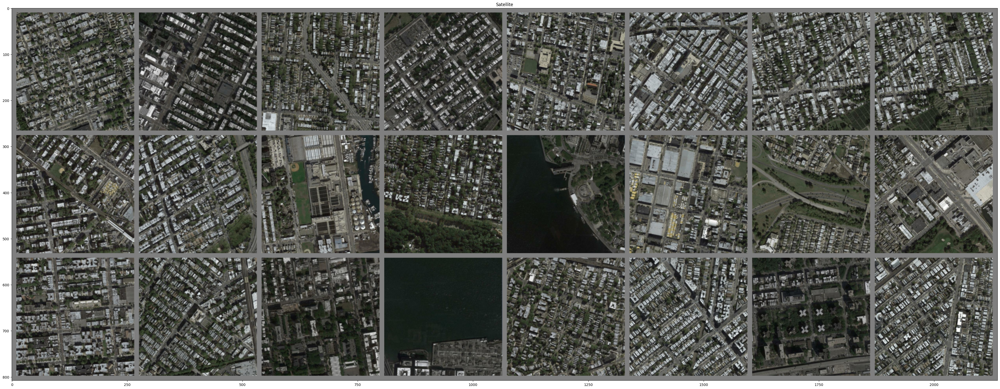

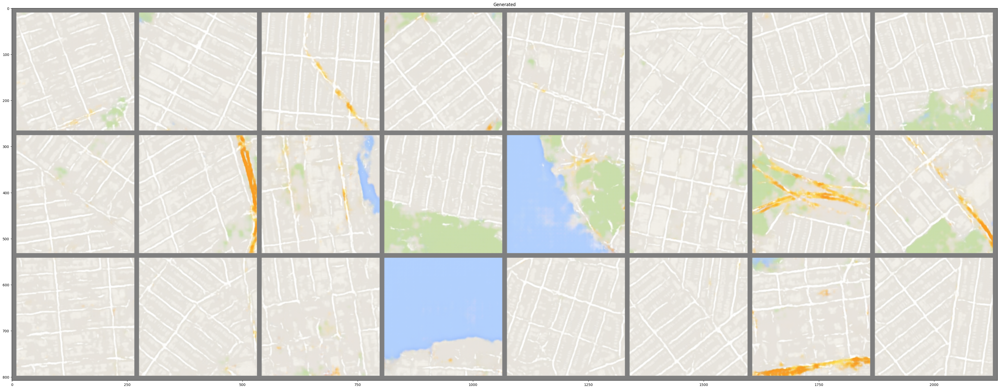

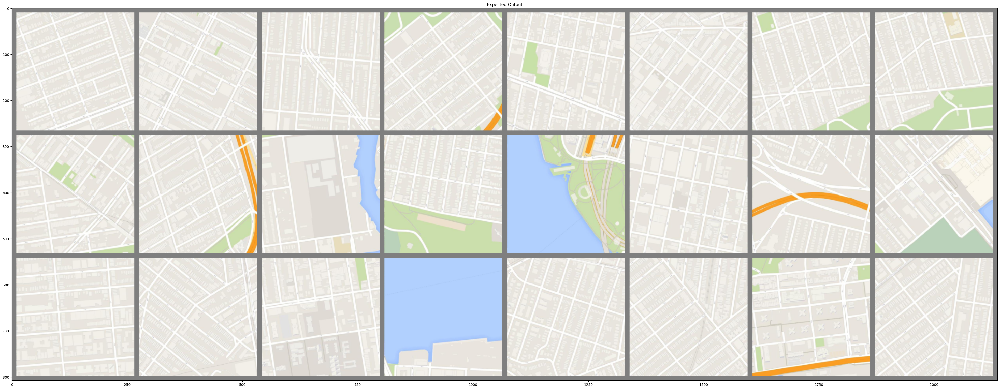

In [45]:
model_G = torch.load("/content/sat2mapGen_epoch100.pth", weights_only=False)
# model_G.apply(weights_init)
test_imgs = next(iter(dataloader_val))

satellite = test_imgs[:,:,:,:256].to(device)
maps = test_imgs[:,:,:,256:].to(device)

gen = model_G(satellite)
# gen = gen[0]

satellite = satellite.detach().cpu()
gen = gen.detach().cpu()
maps = maps.detach().cpu()

show_image(torchvision.utils.make_grid(satellite, padding=10), title="Satellite", figsize=(50,50))
show_image(torchvision.utils.make_grid(gen, padding=10), title="Generated", figsize=(50,50))
show_image(torchvision.utils.make_grid(maps, padding=10), title="Expected Output", figsize=(50,50))

#### We can see that boundaries are not clearly formed here. But if we train the model till 200 epochs it will give us accurate results.